In [115]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/us-accidents/US_Accidents_March23.csv


In [116]:
import pandas as pd
pd.set_option('display.float_format', lambda x: '%.5f' % x)
pd.options.display.max_columns = 100
pd.options.mode.chained_assignment = None
import joblib
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
import seaborn as sns

import re
import gc

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV


from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelBinarizer
from sklearn.preprocessing import MinMaxScaler
from sklearn.compose import make_column_transformer

from sklearn.model_selection import train_test_split

from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import roc_auc_score
from sklearn.exceptions import ConvergenceWarning
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer

from sklearn.linear_model import  RidgeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression


#To ignore the convergence warnings
from  warnings import simplefilter
from sklearn.exceptions import ConvergenceWarning
simplefilter("ignore", category=ConvergenceWarning)

import warnings
warnings.filterwarnings('ignore')

In [117]:
accident_df = pd.read_csv("/kaggle/input/us-accidents/US_Accidents_March23.csv")

In [118]:
# accident_df= accident_df[accident_df['State']=='OH']

In [119]:
accident_df.head()

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Street,City,County,State,Zipcode,Country,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-1,Source2,3,2016-02-08 05:46:00,2016-02-08 11:00:00,39.86515,-84.05872,NaN,NaN,0.01000,Right lane blocked due to accident on I-70 Eas...,I-70 E,Dayton,Montgomery,OH,45424,US,US/Eastern,KFFO,2016-02-08 05:58:00,36.90000,NaN,91.00000,29.68000,10.00000,Calm,NaN,0.02000,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Night
1,A-2,Source2,2,2016-02-08 06:07:59,2016-02-08 06:37:59,39.92806,-82.83118,NaN,NaN,0.01000,Accident on Brice Rd at Tussing Rd. Expect del...,Brice Rd,Reynoldsburg,Franklin,OH,43068-3402,US,US/Eastern,KCMH,2016-02-08 05:51:00,37.90000,NaN,100.00000,29.65000,10.00000,Calm,NaN,0.00000,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Day
2,A-3,Source2,2,2016-02-08 06:49:27,2016-02-08 07:19:27,39.06315,-84.03261,NaN,NaN,0.01000,Accident on OH-32 State Route 32 Westbound at ...,State Route 32,Williamsburg,Clermont,OH,45176,US,US/Eastern,KI69,2016-02-08 06:56:00,36.00000,33.30000,100.00000,29.67000,10.00000,SW,3.50000,NaN,Overcast,False,False,False,False,False,False,False,False,False,False,False,True,False,Night,Night,Day,Day
3,A-4,Source2,3,2016-02-08 07:23:34,2016-02-08 07:53:34,39.74775,-84.20558,NaN,NaN,0.01000,Accident on I-75 Southbound at Exits 52 52B US...,I-75 S,Dayton,Montgomery,OH,45417,US,US/Eastern,KDAY,2016-02-08 07:38:00,35.10000,31.00000,96.00000,29.64000,9.00000,SW,4.60000,NaN,Mostly Cloudy,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Day,Day,Day
4,A-5,Source2,2,2016-02-08 07:39:07,2016-02-08 08:09:07,39.62778,-84.18835,NaN,NaN,0.01000,Accident on McEwen Rd at OH-725 Miamisburg Cen...,Miamisburg Centerville Rd,Dayton,Montgomery,OH,45459,US,US/Eastern,KMGY,2016-02-08 07:53:00,36.00000,33.30000,89.00000,29.65000,6.00000,SW,3.50000,NaN,Mostly Cloudy,False,False,False,False,False,False,False,False,False,False,False,True,False,Day,Day,Day,Day


In [120]:
accident_df.shape

(7728394, 46)

In [121]:
accident_df.dtypes

ID                        object
Source                    object
Severity                   int64
Start_Time                object
End_Time                  object
Start_Lat                float64
Start_Lng                float64
End_Lat                  float64
End_Lng                  float64
Distance(mi)             float64
Description               object
Street                    object
City                      object
County                    object
State                     object
Zipcode                   object
Country                   object
Timezone                  object
Airport_Code              object
Weather_Timestamp         object
Temperature(F)           float64
Wind_Chill(F)            float64
Humidity(%)              float64
Pressure(in)             float64
Visibility(mi)           float64
Wind_Direction            object
Wind_Speed(mph)          float64
Precipitation(in)        float64
Weather_Condition         object
Amenity                     bool
Bump      

In [122]:
accident_df.info(verbose=False, memory_usage="deep")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7728394 entries, 0 to 7728393
Columns: 46 entries, ID to Astronomical_Twilight
dtypes: bool(13), float64(12), int64(1), object(20)
memory usage: 10.6 GB


In [123]:
accident_df['Severity'].value_counts().max() / len(accident_df)

0.7966701749419091

In [124]:
accident_df.isna().sum()

ID                             0
Source                         0
Severity                       0
Start_Time                     0
End_Time                       0
Start_Lat                      0
Start_Lng                      0
End_Lat                  3402762
End_Lng                  3402762
Distance(mi)                   0
Description                    5
Street                     10869
City                         253
County                         0
State                          0
Zipcode                     1915
Country                        0
Timezone                    7808
Airport_Code               22635
Weather_Timestamp         120228
Temperature(F)            163853
Wind_Chill(F)            1999019
Humidity(%)               174144
Pressure(in)              140679
Visibility(mi)            177098
Wind_Direction            175206
Wind_Speed(mph)           571233
Precipitation(in)        2203586
Weather_Condition         173459
Amenity                        0
Bump      

In [125]:
#percentage of missing data
# accident_df.isnull().sum() / len(accident_df)*100

In [126]:
accident_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7728394 entries, 0 to 7728393
Data columns (total 46 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   ID                     object 
 1   Source                 object 
 2   Severity               int64  
 3   Start_Time             object 
 4   End_Time               object 
 5   Start_Lat              float64
 6   Start_Lng              float64
 7   End_Lat                float64
 8   End_Lng                float64
 9   Distance(mi)           float64
 10  Description            object 
 11  Street                 object 
 12  City                   object 
 13  County                 object 
 14  State                  object 
 15  Zipcode                object 
 16  Country                object 
 17  Timezone               object 
 18  Airport_Code           object 
 19  Weather_Timestamp      object 
 20  Temperature(F)         float64
 21  Wind_Chill(F)          float64
 22  Humidity(%)       

In [127]:
accident_df.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,7728394.00000,7728394.00000,7728394.00000,4325632.00000,4325632.00000,7728394.00000,7564541.00000,5729375.00000,7554250.00000,7587715.00000,7551296.00000,7157161.00000,5524808.00000
mean,2.21238,36.20119,-94.70255,36.26183,-95.72557,0.56184,61.66329,58.25105,64.83104,29.53899,9.09038,7.68549,0.00841
std,0.48753,5.07608,17.39176,5.27290,18.10793,1.77681,19.01365,22.38983,22.82097,1.00619,2.68832,5.42498,0.11022
min,1.00000,24.55480,-124.62383,24.56601,-124.54575,0.00000,-89.00000,-89.00000,1.00000,0.00000,0.00000,0.00000,0.00000
25%,2.00000,33.39963,-117.21940,33.46207,-117.75434,0.00000,49.00000,43.00000,48.00000,29.37000,10.00000,4.60000,0.00000
50%,2.00000,35.82397,-87.76662,36.18349,-88.02789,0.03000,64.00000,62.00000,67.00000,29.86000,10.00000,7.00000,0.00000
75%,2.00000,40.08496,-80.35368,40.17892,-80.24709,0.46400,76.00000,75.00000,84.00000,30.03000,10.00000,10.40000,0.00000
max,4.00000,49.00220,-67.11317,49.07500,-67.10924,441.75000,207.00000,207.00000,100.00000,58.63000,140.00000,1087.00000,36.47000


In [128]:
accident_df.columns

Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

In [129]:
# 'Source' 
#No Number, Side

In [130]:
accident_df = accident_df.drop(['ID', 'Source', 'Description','End_Lat','End_Lng','Country',
                  'Turning_Loop','Wind_Chill(F)','Weather_Timestamp',
              'Street','Zipcode',
                 'Airport_Code'], axis=1)

In [131]:
##Missing values
accident_df['City'] = accident_df['City'].fillna('Missing')
accident_df['Weather_Condition'] = accident_df['Weather_Condition'].fillna('Missing')
accident_df['Wind_Direction'] = accident_df['Wind_Direction'].fillna('Missing')
accident_df['Precipitation(in)'] = accident_df['Precipitation(in)'].fillna(0)

accident_df = accident_df.dropna(subset=['Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight'])

In [132]:
accident_df

,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,Distance(mi),City,County,State,Timezone,Temperature(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,3,2016-02-08 05:46:00,2016-02-08 11:00:00,39.86515,-84.05872,0.01000,Dayton,Montgomery,OH,US/Eastern,36.90000,91.00000,29.68000,10.00000,Calm,NaN,0.02000,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Night
1,2,2016-02-08 06:07:59,2016-02-08 06:37:59,39.92806,-82.83118,0.01000,Reynoldsburg,Franklin,OH,US/Eastern,37.90000,100.00000,29.65000,10.00000,Calm,NaN,0.00000,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Day
2,2,2016-02-08 06:49:27,2016-02-08 07:19:27,39.06315,-84.03261,0.01000,Williamsburg,Clermont,OH,US/Eastern,36.00000,100.00000,29.67000,10.00000,SW,3.50000,0.00000,Overcast,False,False,False,False,False,False,False,False,False,False,False,True,Night,Night,Day,Day
3,3,2016-02-08 07:23:34,2016-02-08 07:53:34,39.74775,-84.20558,0.01000,Dayton,Montgomery,OH,US/Eastern,35.10000,96.00000,29.64000,9.00000,SW,4.60000,0.00000,Mostly Cloudy,False,False,False,False,False,False,False,False,False,False,False,False,Night,Day,Day,Day
4,2,2016-02-08 07:39:07,2016-02-08 08:09:07,39.62778,-84.18835,0.01000,Dayton,Montgomery,OH,US/Eastern,36.00000,89.00000,29.65000,6.00000,SW,3.50000,0.00000,Mostly Cloudy,False,False,False,False,False,False,False,False,False,False,False,True,Day,Day,Day,Day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7728389,2,2019-08-23 18:03:25,2019-08-23 18:32:01,34.00248,-117.37936,0.54300,Riverside,Riverside,CA,US/Pacific,86.00000,40.00000,28.92000,10.00000,W,13.00000,0.00000,Fair,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
7728390,2,2019-08-23 19:11:30,2019-08-23 19:38:23,32.76696,-117.14806,0.33800,San Diego,San Diego,CA,US/Pacific,70.00000,73.00000,29.39000,10.00000,SW,6.00000,0.00000,Fair,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
7728391,2,2019-08-23 19:00:21,2019-08-23 19:28:49,33.77545,-117.84779,0.56100,Orange,Orange,CA,US/Pacific,73.00000,64.00000,29.74000,10.00000,SSW,10.00000,0.00000,Partly Cloudy,False,False,False,False,True,False,False,False,False,False,False,False,Day,Day,Day,Day
7728392,2,2019-08-23 19:00:21,2019-08-23 19:29:42,33.99246,-118.40302,0.77200,Culver City,Los Angeles,CA,US/Pacific,71.00000,81.00000,29.62000,10.00000,SW,8.00000,0.00000,Fair,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day


In [133]:
# accident_df['Start_Time'] = accident_df['Start_Time'].astype('timedelta64[m]')
# accident_df['End_Time'] = accident_df['End_Time'].astype('timedelta64[m]')

accident_df['Start_Time'] = pd.to_datetime(accident_df['Start_Time'], format='mixed')
accident_df['End_Time'] = pd.to_datetime(accident_df['End_Time'], format='mixed')
    
accident_df['Year'] = accident_df['Start_Time'].dt.year
accident_df['Month'] = accident_df['Start_Time'].dt.month
accident_df['Day'] = accident_df['Start_Time'].dt.day
accident_df['Hour'] = accident_df['Start_Time'].dt.hour

accident_df['DayofWeek'] = accident_df['Start_Time'].dt.dayofweek   
dayofweek_dict = {0:'Monday', 1:'Tuesday', 2:'Wednesday', 3:'Thursday', 4:'Friday', 5:'Saturday', 6:'Sunday'}
accident_df['DayofWeek'] = accident_df['DayofWeek'].map(dayofweek_dict)

accident_df['Time_Diff'] = (accident_df['End_Time'] - accident_df['Start_Time'])

accident_df = accident_df.drop(['Start_Time','End_Time'], axis=1)


In [134]:
# accident_df['Time_Diff'].dtype

In [135]:
# Setup main attributes and target variable
# X = accident_df.iloc[:,3:]
# X = accident_df[['Start_Lat']] # full data set of original features to include in model building (only exclused id field & class label)
# y = accident_df[['Severity']] # convert y to 1-D array for .fit

In [136]:
# accident_df.iloc[3638060]

In [137]:
def remove_outliers(df,col):

    cutoff = df[col].std()*3
    lower_limit = df[col].mean() - cutoff
    upper_limit = df[col].mean() + cutoff
    
    df = df[(df[col] > lower_limit) & (df[col] < upper_limit)]
    return df

In [138]:
def impute_missing_mean(df,col):

    df[col] = df[col].fillna(df[col].mean())
    return df

In [139]:
def impute_missing_median(df,col):

    df[col] = df[col].fillna(df[col].median())
    return df

In [140]:
# accident_df['Zipcode'] = accident_df['Zipcode'].str[0:5]

In [141]:
accident_df['Wind_Direction'] = accident_df['Wind_Direction'].str.upper()
accident_df['Wind_Direction'] = accident_df['Wind_Direction'].str.replace('SOUTH','S')
accident_df['Wind_Direction'] = accident_df['Wind_Direction'].str.replace('WEST','W')
accident_df['Wind_Direction'] = accident_df['Wind_Direction'].str.replace('NORTH','N')
accident_df['Wind_Direction'] = accident_df['Wind_Direction'].str.replace('EAST','E')

In [142]:
top_weather_conditions = accident_df['Weather_Condition'].value_counts().head(15).index
accident_df['Weather_Condition'] = np.where(accident_df['Weather_Condition'].isin(top_weather_conditions),
                                   accident_df['Weather_Condition'], 'Other')


In [143]:
def bar(x,y,color,title,xlabel,ylabel):
    fig = px.bar(x=x, y=y, color=color)
    
    fig.update_layout(
    title = title,
    xaxis_title=xlabel,
    yaxis_title=ylabel)
    
    fig.show()

In [144]:
# def reduce_mem_usage(df):
    
#     """Code from https://www.mikulskibartosz.name/how-to-reduce-memory-usage-in-pandas/"""
#     start_mem = df.memory_usage().sum() / 1024**2
#     print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))

#     for col in df.columns:
#         col_type = df[col].dtype
#     if col_type != object:
#             c_min = df[col].min()
#             c_max = df[col].max()
#             if str(col_type)[:3] == 'int':
#                 if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
#                     df[col] = df[col].astype(np.int8)
#                 elif c_min > np.iinfo(np.uint8).min and c_max < np.iinfo(np.uint8).max:
#                     df[col] = df[col].astype(np.uint8)
#                 elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
#                     df[col] = df[col].astype(np.int16)
#                 elif c_min > np.iinfo(np.uint16).min and c_max < np.iinfo(np.uint16).max:
#                     df[col] = df[col].astype(np.uint16)
#                 elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
#                     df[col] = df[col].astype(np.int32)
#                 elif c_min > np.iinfo(np.uint32).min and c_max < np.iinfo(np.uint32).max:
#                     df[col] = df[col].astype(np.uint32)                    
#                 elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
#                     df[col] = df[col].astype(np.int64)
#                 elif c_min > np.iinfo(np.uint64).min and c_max < np.iinfo(np.uint64).max:
#                     df[col] = df[col].astype(np.uint64)
#             elif str(col_type)[:5] == 'float':
#                 if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
#                     df[col] = df[col].astype(np.float16)
#                 elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
#                     df[col] = df[col].astype(np.float32)
#                 else:
#                     df[col] = df[col].astype(np.float64)

#     end_mem = df.memory_usage().sum() / 1024**2
#     print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
#     print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
#     return df

In [145]:
# accident_df[accident_df['Time_Diff'] >= 0.0].copy()

# accident_df['Time_Diff'].dt.total_seconds() <= 0
accident_df['Time_Diff'] = accident_df['Time_Diff'].dt.total_seconds() / 60

In [146]:
cols =['Time_Diff','Temperature(F)','Humidity(%)','Pressure(in)','Visibility(mi)']
for col in cols:
    c = accident_df.shape[0]
    accident_df =remove_outliers(accident_df,col)
    n = accident_df.shape[0]
    print("{} new outliers detected for {} and removed".format(c-n,col))

5378 new outliers detected for Time_Diff and removed
195219 new outliers detected for Temperature(F) and removed
9994 new outliers detected for Humidity(%) and removed
237039 new outliers detected for Pressure(in) and removed
248505 new outliers detected for Visibility(mi) and removed


In [147]:
accident_df = impute_missing_median(accident_df,'Wind_Speed(mph)')

In [148]:
high_severity_ = accident_df[(accident_df['Severity']==3) | (accident_df['Severity']==4) ]

In [149]:
fig = px.pie(accident_df, values='Severity', names='Severity', title='Distribution of Accidents by Severity')
fig.show()

In [150]:
bar(x=accident_df.groupby('State')['State'].count().sort_values(ascending=False).head(20).index,
    y=accident_df.groupby('State')['State'].count().sort_values(ascending=False).head(20).values,
   color = accident_df.groupby('State')['State'].count().sort_values(ascending=False).head(20).index,
    title="Top 20 States with Most Accidents", xlabel='States', ylabel='Count of Accidents')

In [151]:
bar(x=accident_df.groupby('City')['City'].count().sort_values(ascending=False).head(20).index,
    y=accident_df.groupby('City')['City'].count().sort_values(ascending=False).head(20).values,
   color = accident_df.groupby('City')['City'].count().sort_values(ascending=False).head(20).index,
    title="Top 20 Cities with Most Accidents", xlabel='Cities', ylabel='Count of Accidents')

In [152]:
bar(x=high_severity_.groupby('City')['City'].count().sort_values(ascending=False).head(20).index,
    y=high_severity_.groupby('City')['City'].count().sort_values(ascending=False).head(20).values,
   color = high_severity_.groupby('City')['City'].count().sort_values(ascending=False).head(20).index,
    title="Top 20 Cities with Most Severity 3 & 4 Accidents", xlabel='Cities', ylabel='Count of Accidents')

In [153]:
bar(x=accident_df.groupby(['Timezone'])['Timezone'].count().index,
   y=accident_df.groupby(['Timezone'])['Timezone'].count().values,
   color=accident_df.groupby(['Timezone'])['Timezone'].count().index,
   title="Accidents by Timezone", xlabel='Timezone', ylabel='Count of Accidents')

In [154]:
accident_df.groupby('Weather_Condition')['Weather_Condition'].count().sort_values(ascending=False).head(10)

Weather_Condition
Fair                2416286
Mostly Cloudy        970105
Clear                794145
Cloudy               773346
Partly Cloudy        663063
Overcast             369651
Light Rain           329496
Scattered Clouds     200847
Other                191678
Rain                  74623
Name: Weather_Condition, dtype: int64

In [155]:
bar(x=accident_df.groupby('Weather_Condition')['Weather_Condition'].count().sort_values(ascending=False).head(10).index,
   y=accident_df.groupby('Weather_Condition')['Weather_Condition'].count().sort_values(ascending=False).head(10).values,
   color=accident_df.groupby('Weather_Condition')['Weather_Condition'].count().sort_values(ascending=False).head(10).index,
   title='Top 10 Most Common Weather Conditions When Accidents Occur', xlabel='Weather Condition', ylabel='Count of Accidents')

In [156]:
fig = make_subplots(rows=2, cols=2, subplot_titles=("Number of Accidents by Year", "Number of Accidents by Month",
                                                    "Number of Accidents by Day of Week", "Number of Accidents by the Hour"))

fig.append_trace(go.Bar(
    x=accident_df.groupby('Year')['Year'].count().index,
    y=accident_df.groupby('Year')['Year'].count().values,
    name='Year'),
    row=1, col=1)

fig.append_trace(go.Bar(
    x=accident_df.groupby('Month')['Month'].count().index,
    y=accident_df.groupby('Month')['Month'].count().values,
    name='Month'),
    row=1, col=2)

fig.append_trace(go.Bar(
    x=accident_df.groupby('DayofWeek',sort=False)['DayofWeek'].count().index,
    y=accident_df.groupby('DayofWeek',sort=False)['DayofWeek'].count().values,
    name='Day of Week'),
    row=2, col=1)

fig.append_trace(go.Bar(
    x=accident_df.groupby('Hour')['Hour'].count().index,
    y=accident_df.groupby('Hour')['Hour'].count().values,
    name='Hour'),
    row=2, col=2)

fig.update_layout(height=1200, width=1200, xaxis_showticklabels=True)
fig.show()

In [157]:
fig = make_subplots(rows=2, cols=2, subplot_titles=('Sunrise Sunset','Civil Twilight',' Nautical Twilight','Astronomical Twilight'))

fig.append_trace(go.Bar(
    x=accident_df.groupby('Sunrise_Sunset')['Sunrise_Sunset'].count().index,
    y=accident_df.groupby('Sunrise_Sunset')['Sunrise_Sunset'].count().values,
    name='Year'),
    row=1, col=1)

fig.append_trace(go.Bar(
    x=accident_df.groupby('Civil_Twilight')['Civil_Twilight'].count().index,
    y=accident_df.groupby('Civil_Twilight')['Civil_Twilight'].count().values,
    name='Month'),
    row=1, col=2)

fig.append_trace(go.Bar(
    x=accident_df.groupby('Nautical_Twilight')['Nautical_Twilight'].count().index,
    y=accident_df.groupby('Nautical_Twilight')['Nautical_Twilight'].count().values,
    name='Day of Week'),
    row=2, col=1)

fig.append_trace(go.Bar(
    x=accident_df.groupby('Astronomical_Twilight')['Astronomical_Twilight'].count().index,
    y=accident_df.groupby('Astronomical_Twilight')['Astronomical_Twilight'].count().values,
    name='Hour'),
    row=2, col=2)


fig.update_layout(height=1200, width=1200, xaxis_showticklabels=True)
fig.show()

In [158]:
accident_df.groupby('Severity')[['Temperature(F)','Humidity(%)','Pressure(in)','Visibility(mi)','Wind_Speed(mph)','Precipitation(in)']].mean()

,Temperature(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
Severity,,,,,,
1,72.78440,62.68821,29.38337,9.56826,7.12356,0.00392
2,62.82700,64.14831,29.66873,9.31476,7.51887,0.00452
3,63.09323,65.20152,29.80661,9.20973,8.17471,0.00726
4,59.41367,67.20503,29.65454,9.29955,7.53382,0.00427


In [159]:
del high_severity_
del cols
del fig
gc.collect()

2778

In [160]:
# accident_df = reduce_mem_usage(accident_df)

In [161]:
accident_df['Severity'].value_counts()

Severity
2    5577611
3    1192620
4     176741
1      62041
Name: count, dtype: int64

In [162]:
#create a small straitifed sample
severity_1 = len(accident_df[accident_df['Severity'] == 1])
severity_2 = len(accident_df[accident_df['Severity'] == 2])
severity_3 = len(accident_df[accident_df['Severity'] == 3])
severity_4 = len(accident_df[accident_df['Severity'] == 4])

accident_df_1 = accident_df[accident_df['Severity']==1].head(round(severity_1/50))
accident_df_2 = accident_df[accident_df['Severity']==2].head(round(severity_2/50))
accident_df_3 = accident_df[accident_df['Severity']==3].head(round(severity_3/50))
accident_df_4 = accident_df[accident_df['Severity']==4].head(round(severity_4/50))

processed_accident_df = pd.concat([accident_df_1, accident_df_2,
                                accident_df_3, accident_df_4], ignore_index=True)

del accident_df_1
del accident_df_2
del accident_df_3
del accident_df_4

gc.collect()

0

In [163]:
#create a large straitified sample
large_accident_df_1 = accident_df[accident_df['Severity']==1].head(round(severity_1/20))
large_accident_df_2 = accident_df[accident_df['Severity']==2].head(round(severity_2/20))
large_accident_df_3 = accident_df[accident_df['Severity']==3].head(round(severity_3/20))
large_accident_df_4 = accident_df[accident_df['Severity']==4].head(round(severity_4/20))

large_accident_df = pd.concat([large_accident_df_1, large_accident_df_2,
                                large_accident_df_3, large_accident_df_4], ignore_index=True)
del large_accident_df_1
del large_accident_df_2
del large_accident_df_3
del large_accident_df_4
del severity_1
del severity_2
del severity_3
del severity_4

gc.collect()

0

In [164]:
# del accident_df
# gc.collect()

In [165]:
def create_dummy(df, column_name):
    """
    create dummy variables
    
    Args: df: dataframe, col: columns to transform to dummy variables
    
    Returns: dataframe with the dummy variable columns 
    """
    dummies = pd.get_dummies(df[column_name], prefix = column_name)
    df = pd.concat([df, dummies], axis = 1)
    return df

In [166]:
def train_model(algo_name, model, X_train, y_train):
    """
    Fits the estimator and calculates the average f1 score accross 5-fold cross validations.
    
    Args: algo_name: string name for algorithm, model: estimator,
    X_train: the training part of the first sequence (X),
    y_train: the training part of teh second sequence (y)
    
    Returns: A dataframe with the algoithm's name, average f1 score across 5-fold cross validations.
    """
    model.fit(X_train, y_train)
    avg_f1 = cross_val_score(model, X_train, y_train, scoring = make_scorer(f1_score, average='weighted', labels=[2]), cv = 5).mean()
    
    train_model_results = pd.DataFrame({
        'Algorithm':["{}".format(algo_name)],
        'CV F1':[avg_f1]
    })
    
    return train_model_results

In [167]:
def test_model(algo_name, model, X_train, y_train, X_test, y_test):
    """
    Fits the estimator on the training data and calculates the average f1 score 4-fold cross validations with the testing data.
    
    Args: algo_name: string name for algorithm, model: estimator,
    X_train: the training part of the first sequence (X),
    y_train: the training part of teh second sequence (y),
    X_test: the test part of the first sequence (X),
    y_test: the test part of the second sequence (y)

    Returns: A dataframe with the algoithm's name, the f1 score across 4-fold cross validations.
    """
    model.fit(X_train, y_train)

    avg_f1 = cross_val_score(model, X_test, y_test, scoring =make_scorer(f1_score, average='weighted', labels=[2]), cv = 5).mean()

    
    test_model_results = pd.DataFrame({
        'Algorithm':["{}".format(algo_name)],
        'CV F1':[avg_f1],
 
    })
    
    return test_model_results

In [168]:
processed_accident_df_X = processed_accident_df.drop('Severity', axis=1)
processed_accident_df_y = processed_accident_df['Severity']

In [169]:
## handling imbalances
from collections import Counter
from imblearn.under_sampling import RandomUnderSampler

# perform oversampling in the train set

print('Original dataset shape %s' % Counter(processed_accident_df_y))

ros = RandomUnderSampler(random_state=42) # default sampling strategy: resample all classes but the majority class
processed_accident_df_X, processed_accident_df_y = ros.fit_resample(processed_accident_df_X, processed_accident_df_y)

print('Resampled train dataset shape %s' % Counter(processed_accident_df_y))

Original dataset shape Counter({2: 111552, 3: 23852, 4: 3535, 1: 1241})
Resampled train dataset shape Counter({1: 1241, 2: 1241, 3: 1241, 4: 1241})


In [170]:
len(processed_accident_df_y)

4964

In [171]:
#split the dataset
X_train, X_test, y_train, y_test = train_test_split(processed_accident_df_X, processed_accident_df_y,
                                                    test_size = 0.2, random_state = 123,
                                                   stratify=processed_accident_df_y,
                                                   shuffle=True)

In [172]:
# from collections import Counter
# from imblearn.over_sampling import RandomOverSampler
# # perform oversampling in the train set

# print('Original dataset shape %s' % Counter(processed_accident_df_y))
# print('Train dataset shape %s' % Counter(y_train))
# print('Test dataset shape %s' % Counter(y_test))

# ros = RandomOverSampler(random_state=42) # default sampling strategy: resample all classes but the majority class
# X_train, y_train = ros.fit_resample(X_train, y_train)

# print('Resampled train dataset shape %s' % Counter(y_oversampled_train))

In [173]:
# del processed_accident_df_X
# del processed_accident_df_y

# gc.collect()

In [174]:
#binarize the columns for the X_train and X_test
transformer = LabelBinarizer()
binary_cols = ['Amenity','Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal']

for col in binary_cols:
    processed_accident_df_X[col] = transformer.fit_transform(processed_accident_df_X[col]).ravel()
#     X_test[col] = transformer.fit_transform(X_test[col]).ravel()

In [175]:
#one hot encode the columns for the X_train and X_test
ohe = OneHotEncoder(sparse = False)

ohe_cols =['City','County','State', 'Timezone', 'Wind_Direction', 'Weather_Condition',
           'Sunrise_Sunset', 'Civil_Twilight','Nautical_Twilight', 'Astronomical_Twilight',
            'Year', 'Month', 'Day', 'Hour', 'DayofWeek']

column_trans = make_column_transformer((
                ohe, ohe_cols), remainder='passthrough')

processed_accident_df_X = column_trans.fit_transform(processed_accident_df_X)
# X_test =column_trans.fit_transform(X_test)

In [176]:
# X_train

In [177]:
processed_accident_df_X

array([[  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,  45.        ],
       [  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,  30.        ],
       [  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,  45.        ],
       ...,
       [  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,  73.36666667],
       [  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        , 119.23333333],
       [  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,  75.23333333]])

In [178]:
# X_train.shape

In [179]:
# processed_accident_df_X.shape

In [180]:
# X_test.shape

In [181]:
# scaler = MinMaxScaler()

# X_train_sc = scaler.fit_transform(X_train)
# X_test_sc = scaler.fit_transform(X_test)

In [182]:
scaler = MinMaxScaler()

processed_accident_df_X_sc = scaler.fit_transform(processed_accident_df_X)
# X_test_sc = scaler.fit_transform(X_test)

In [183]:
# dffvf

In [211]:
processed_accident_df_X.shape

(4964, 2016)

In [184]:
untuned_KNN = train_model(algo_name = 'Untuned KNN', model = KNeighborsClassifier() , X_train = processed_accident_df_X_sc, y_train = processed_accident_df_y)
untuned_KNN

,Algorithm,CV F1
0,Untuned KNN,0.68247


In [185]:
untuned_DT = train_model(algo_name = 'Untuned Decision Tree', model = DecisionTreeClassifier() , X_train = processed_accident_df_X, y_train = processed_accident_df_y)
untuned_DT

,Algorithm,CV F1
0,Untuned Decision Tree,0.75021


In [186]:
untuned_LR = train_model(algo_name = 'Untuned Logistic Regression', model = LogisticRegression() , X_train = processed_accident_df_X, y_train = processed_accident_df_y)
untuned_LR

,Algorithm,CV F1
0,Untuned Logistic Regression,0.55388


In [187]:
training_results = pd.concat([
                            untuned_KNN,
                            untuned_DT,
                            untuned_LR], axis=0, ignore_index=True)
training_results

,Algorithm,CV F1
0,Untuned KNN,0.68247
1,Untuned Decision Tree,0.75021
2,Untuned Logistic Regression,0.55388


In [188]:
del untuned_KNN
del untuned_DT
del untuned_LR
gc.collect()

225

PARAMETER OPTIMIZATION

In [189]:
############################### Import Libraries & Modules #################################
from sklearn.tree import DecisionTreeClassifier # A decision tree classifier
from sklearn.model_selection import GridSearchCV, KFold, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn import neighbors, datasets
# Standardize features by removing the mean and scaling to unit variance
from sklearn.preprocessing import StandardScaler
# Pipeline of transforms with a final estimator
from sklearn.pipeline import Pipeline
np.random.seed(42) # ensure reproducability

from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier # A decision tree classifier
from sklearn.model_selection import GridSearchCV, KFold, cross_val_score

random_state=42

In [190]:
#Inner and outer 5 cross-validation splits
inner_cv = KFold(n_splits=5,shuffle=True,random_state=random_state)
outer_cv = KFold(n_splits=5,shuffle=True,random_state=random_state)

In [191]:
import warnings
warnings.filterwarnings('ignore')
#Normalize Data
pipe = Pipeline([
        ('sc', StandardScaler()),
        ('knn', KNeighborsClassifier(p=2,
                                     metric='minkowski'))
      ])
##
params = {
        'knn__n_neighbors': [1,3,5,7,9,11,13,15,17,19,21],
        'knn__weights': ['uniform'],
        'knn__algorithm': ['auto']
    }

gs_knn2 = GridSearchCV(estimator=pipe,
                  param_grid=params,
                  scoring='f1_macro',
                  cv=inner_cv,
                  n_jobs=4)
gs_knn2 = gs_knn2.fit(processed_accident_df_X,processed_accident_df_y)
print("\n Parameter Tuning #7")
print("Non-nested CV F1: ", gs_knn2.best_score_)
print("Optimal Parameter: ", gs_knn2.best_params_)
print("Optimal Estimator: ", gs_knn2.best_estimator_) # Estimator that was chosen by the search, i.e. estimator which gave highest score
nested_score_gs_knn2 = cross_val_score(gs_knn2, X=processed_accident_df_X, y=processed_accident_df_y, cv=outer_cv)
print("Nested CV F1: ",nested_score_gs_knn2.mean(), " +/- ", nested_score_gs_knn2.std())


 Parameter Tuning #7
Non-nested CV F1:  0.6118976847742504
Optimal Parameter:  {'knn__algorithm': 'auto', 'knn__n_neighbors': 1, 'knn__weights': 'uniform'}
Optimal Estimator:  Pipeline(steps=[('sc', StandardScaler()),
                ('knn', KNeighborsClassifier(n_neighbors=1))])
Nested CV F1:  0.6118976847742504  +/-  0.012543647876648446


In [192]:
gs = GridSearchCV(estimator=DecisionTreeClassifier(random_state=42),
                  param_grid=[{'max_depth': [4, 8, None],
                               'min_samples_leaf':[2]
                               }],
                  scoring='f1_macro',
                  cv=inner_cv)

gs = gs.fit(processed_accident_df_X,processed_accident_df_y)
print("Parameter Tuning for Decision Tree")
print("Non-nested CV F1-score: ", gs.best_score_)
print("Optimal Parameter: ", gs.best_params_)    # Parameter setting that gave the best results on the hold out data.
print("Optimal Estimator: ", gs.best_estimator_) # Estimator that was chosen by the search, i.e. estimator which gave highest score
nested_score_gs = cross_val_score(gs, X=processed_accident_df_X, y=processed_accident_df_y,scoring='f1_macro',  cv=outer_cv)
print("Nested CV F1-score: ",nested_score_gs.mean(), " +/- ", nested_score_gs.std())

Parameter Tuning for Decision Tree
Non-nested CV F1-score:  0.8648228799942933
Optimal Parameter:  {'max_depth': 8, 'min_samples_leaf': 2}
Optimal Estimator:  DecisionTreeClassifier(max_depth=8, min_samples_leaf=2, random_state=42)
Nested CV F1-score:  0.8648228799942933  +/-  0.010860122493979905


In [193]:
############################ Logistic Regression Parameter Tuning ############################
#To ignore the convergence warnings
from  warnings import simplefilter
from sklearn.exceptions import ConvergenceWarning
simplefilter("ignore", category=ConvergenceWarning)

gs_lr2 = GridSearchCV(estimator=LogisticRegression(random_state=42, solver='liblinear'),
                  param_grid=[{'C': [ 0.01,1,100],
                              'penalty':['l2'],
                               'multi_class':['auto']}],
                  scoring='f1_macro',
                  cv=inner_cv)

gs_lr2 = gs_lr2.fit(processed_accident_df_X,processed_accident_df_y)
print("\n Parameter Tuning #5")
print("Non-nested CV F1: ", gs_lr2.best_score_)
print("Optimal Parameter: ", gs_lr2.best_params_)
print("Optimal Estimator: ", gs_lr2.best_estimator_)
nested_score_gs_lr2 = cross_val_score(gs_lr2, X=processed_accident_df_X, y=processed_accident_df_y, cv=outer_cv)
print("Nested CV F1:",nested_score_gs_lr2.mean(), " +/- ", nested_score_gs_lr2.std())


 Parameter Tuning #5
Non-nested CV F1:  0.8740931617570762
Optimal Parameter:  {'C': 1, 'multi_class': 'auto', 'penalty': 'l2'}
Optimal Estimator:  LogisticRegression(C=1, random_state=42, solver='liblinear')
Nested CV F1: 0.8740931617570762  +/-  0.009433924876007884


In [194]:
from tabulate import tabulate
table = [['Classifier', 'mean', '+/- STD'],
         ['k-NN', nested_score_gs_knn2.mean(), nested_score_gs_knn2.std()],
         ['Decision Tree', nested_score_gs.mean(), nested_score_gs.std()],
         ['Logistic Regression', nested_score_gs_lr2.mean(), nested_score_gs_lr2.std()]]
print(tabulate(table, headers="firstrow"))

Classifier               mean     +/- STD
-------------------  --------  ----------
k-NN                 0.611898  0.0125436
Decision Tree        0.864823  0.0108601
Logistic Regression  0.874093  0.00943392


**LEARNING CURVE**

In [195]:
from __future__ import division, print_function, unicode_literals
from sklearn import linear_model       # the sklearn.linear_model module implements generalized linear models
from sklearn.model_selection import learning_curve # determines cross-validated training and test scores for different training set sizes
from sklearn.model_selection import ShuffleSplit
from sklearn.linear_model import LogisticRegression
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

In [196]:

def plot_learning_curve(estimator,        # data science algorithm
                        title,            # title of the plot
                        X, y,             # data (features and target variable)
                        ylim=None,        # minimum and maximum y values plotted
                        cv=None,          # cross validation splits
                        n_jobs=1,         # parallell estimation using multiple processors
                        train_sizes=np.linspace(.1, 1.0, 10)): #linspace returns evenly spaced numbers over a specified interval (start, stop, num)


    # Initialization of Figure
    plt.figure()                    # display figure

    # Titles/labels for the plot are set
    plt.title(title)                # specify title based on parameter provided as input
    if ylim is not None:            # if ylim was specified as an input, make sure the plots use these limits
        plt.ylim(*ylim)
    plt.xlabel("Training examples") # y label title
    plt.ylabel("Score")             # x label title

    train_sizes, train_scores, test_scores = learning_curve(estimator, # data science algorithm
                                                            X, y,      # data (features and target variable)
                                                            cv=cv,     # cross-validation folds
                                                            n_jobs=n_jobs, # number of jobs to run in parallel using multiple processors
                                                            train_sizes=train_sizes) # relative or absolute numbers of training examples
                                                                                     # that will be used to generate the learning curve

    # Score Calculations
    # Cross validation statistics for training and testing data (mean and standard deviation)
    train_scores_mean = np.mean(train_scores, axis=1) # compute the arithmetic mean along the specified axis.
    train_scores_std = np.std(train_scores, axis=1)   # compute the standard deviation along the specified axis.
    test_scores_mean = np.mean(test_scores, axis=1)   # compute the arithmetic mean along the specified axis.
    test_scores_std = np.std(test_scores, axis=1)     # compute the standard deviation along the specified axis.

    # Visualization of Learning Curve
    plt.grid()                                        # configure the grid lines in the plot
                                                      # adds grid lines to the plot for better visualization and understanding of the data points

    # Fill Between Scores to Indicate Standard Deviation
    # Fill the area around the line to indicate the size of standard deviations for the training data
    # and the test data
    # The area filled represents one standard deviation above and below the mean of the training/test scores
    plt.fill_between(train_sizes,                            # the x coordinates of the nodes defining the curves
                     train_scores_mean - train_scores_std,   # the y coordinates of the nodes defining the first curve
                     train_scores_mean + train_scores_std,   # the y coordinates of the nodes defining the second curve
                     alpha=0.1,                              # level of transparency in the color fill
                     color="r")                              # train data performance indicated with red
    plt.fill_between(train_sizes,
                     test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std,
                     alpha=0.1,
                     color="g")                              # test data performance indicated with green

    # Plotting the Mean Scores
    # Cross-validation mean scores indicated by dots
    # Train data performance indicated with red
    plt.plot(train_sizes,                                    # the horizontal coordinates of the data points
             train_scores_mean,                              # the vertical coordinates of the data points
             'o-',                                           # o- will produce a small circle and a solid line to connect the markers
             color="r",                                      # line of red color
             label="Training score")                         # specify label title for this plot

    # Test data performance indicated with green
    plt.plot(train_sizes,
             test_scores_mean,
             'o-',
             color="g",                                      # line of green color
             label="Cross-validation score")

    plt.legend(loc="best")                      # show legend of the plot at the best location possible
                                                # placing it in the "best" location based on where matplotlib thinks it will least overlap with other elements
    return plt                                  # function that returns the plot as an output

In [197]:
# title = "Learning Curve (Decision Tree)"

# # Initializes the ShuffleSplit cross-validator & an instance of the logistic regression model
# # Class ShuffleSplit is a random permutation cross-validator
# cv = ShuffleSplit(n_splits=10,          # number of re-shuffling & splitting iterations
#                   test_size=0.3,        # represents the proportion of the dataset to include in the test split (float between 0.0 and 1.0)
#                   random_state=42)      # the seed used by the random number generator
# estimator = DecisionTreeClassifier(max_depth=5, min_samples_leaf=5, random_state=42)        # build multiple LR models as we increase the size of the traning data

# # Plots the learning curve based on the previously defined function for the logistic regression estimator
# plot_learning_curve(estimator,      # data science algorithm
#                     title,          # title of the plot
#                     processed_accident_df_X, processed_accident_df_y,           # data (features and target variable)
#                     (0.8, 1.01),    # minimum and maximum y values plotted
#                     cv=cv,          # cross-validation folds (produced above)
#                     n_jobs=4)       # parallell estimation using multiple processors (ie., 4 cores here)

# plt.show()                          # display the figure

/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

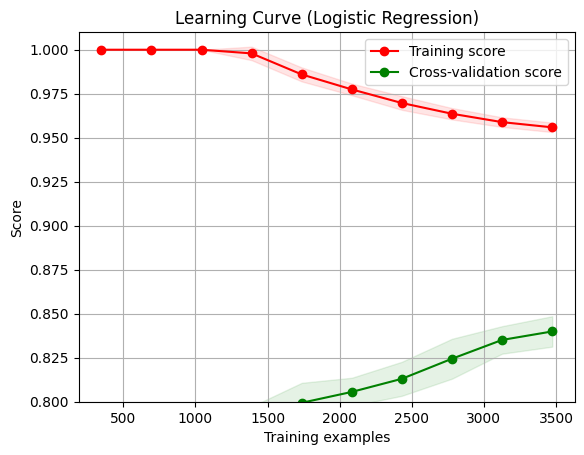

In [198]:
title = "Learning Curve (Logistic Regression)"

# Initializes the ShuffleSplit cross-validator & an instance of the logistic regression model
# Class ShuffleSplit is a random permutation cross-validator
cv = ShuffleSplit(n_splits=10,          # number of re-shuffling & splitting iterations
                  test_size=0.3,        # represents the proportion of the dataset to include in the test split (float between 0.0 and 1.0)
                  random_state=42)      # the seed used by the random number generator
estimator = LogisticRegression(C=100, penalty='l1', random_state=42, solver='liblinear')        # build multiple LR models as we increase the size of the traning data

# Plots the learning curve based on the previously defined function for the logistic regression estimator
plot_learning_curve(estimator,      # data science algorithm
                    title,          # title of the plot
                    processed_accident_df_X, processed_accident_df_y,           # data (features and target variable)
                    (0.8, 1.01),    # minimum and maximum y values plotted
                    cv=cv,          # cross-validation folds (produced above)
                    n_jobs=4)       # parallell estimation using multiple processors (ie., 4 cores here)

plt.show()                          # display the figure

**FITTING GRAPH**

In [199]:
from sklearn.tree import DecisionTreeClassifier # A decision tree classifier
import pandas as pd
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import LabelEncoder       # this transformer should be used to encode target values, i.e. y, and not the input X
from sklearn.model_selection import train_test_split

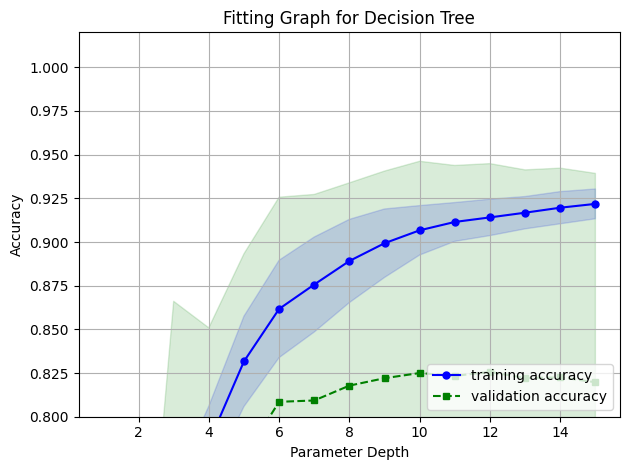

In [200]:
from sklearn.model_selection import validation_curve
np.random.seed(42)                        # the seed used by the random number generator for np

depth_range = [1, 2, 3, 3, 4 , 4 ,5 , 6 , 7, 8, 9, 10, 11, 12, 13, 14, 15]

train_scores, test_scores = validation_curve(
                estimator=DecisionTreeClassifier(max_depth=5, min_samples_leaf=5, random_state=42), # build Logistic Regression models
                X=processed_accident_df_X,                                    # data (features)
                y=processed_accident_df_y,                                    # target variable
                param_name="max_depth",                               # parameter C: Inverse of regularization strength;
                                                              # must be a positive float. Smaller values of paramter C specify
                                                              # stronger regularization.
                param_range=depth_range,                      # the values of the parameter that will be evaluated

                cv=10,                                        # 10-fold cross-validation
                scoring="f1_macro",                           # evaluation metric
                n_jobs=4)

# Cross validation statistics for training and testing data (mean and standard deviation)
train_mean = np.mean(train_scores, axis=1) # compute the arithmetic mean along the specified axis (train data)
train_std = np.std(train_scores, axis=1)   # compute the standard deviation along the specified axis (train data)
test_mean = np.mean(test_scores, axis=1)   # compute the arithmetic mean along the specified axis (test data)
test_std = np.std(test_scores, axis=1)     # compute the standard deviation along the specified axis (test data)



plt.plot(depth_range,                     # the horizontal coordinates of the data points
         train_mean,                      # the vertical coordinates of the data points
         color='blue',                    # aesthetic parameter - color
         marker='o',                      # aesthetic parameter - marker
         markersize=5,                    # aesthetic parameter - size of marker
         label='training accuracy')


plt.fill_between(depth_range,             # the x coordinates of the nodes defining the curves
                 train_mean + train_std,  # the y coordinates of the nodes defining the first curve
                 train_mean - train_std,  # the y coordinates of the nodes defining the second curve
                 alpha=0.15,              # level of transparency in the color fill
                 color='blue')            # aesthetic parameter - color


plt.plot(depth_range,
         test_mean,
         color='green',
         linestyle='--',
         marker='s',
         markersize=5,
         label='validation accuracy')

plt.fill_between(depth_range,
                 test_mean + test_std,
                 test_mean - test_std,
                 alpha=0.15, color='green')




plt.grid()
# plt.xscale('log')
plt.legend(loc='lower right')
plt.title("Fitting Graph for Decision Tree")
plt.xlabel('Parameter Depth')
plt.ylabel('Accuracy')
plt.ylim([0.8, 1.02]) # y limits in the plot
plt.tight_layout()
# plt.savefig('Fitting_graph_LR.png', dpi=300)
plt.show()                            # display the figure


**ROC GRAPH**

In [201]:
X_train, X_test, y_train, y_test = train_test_split(processed_accident_df_X,
                                                    processed_accident_df_y,
                                                    test_size=0.20,
                                                    random_state=42)

In [202]:
############################### Import Libraries & Modules #################################

import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

In [203]:
clf1 = LogisticRegression(C=100, penalty='l1', random_state=42, solver='liblinear')


# Decision Tree Classifier
clf2 = DecisionTreeClassifier(max_depth=5, min_samples_leaf=5, random_state=42)

# kNN Classifier

clf3 = Pipeline([
        ('sc', StandardScaler()),
        ('knn', KNeighborsClassifier(n_neighbors=9))
      ])


# Label the classifiers
clf_labels = ['Logistic regression', 'Decision tree', 'kNN']
all_clf = [clf1, clf2, clf3]


print('Performance based on 10-fold cross validation:\n')
for clf, label in zip(all_clf, clf_labels): #For all classifiers
    scores = cross_val_score(estimator=clf,  # estimate AUC based on cross validation
                             X=processed_accident_df_X,
                             y=processed_accident_df_y,
                             cv=10,
                             scoring='f1_macro')
    print("ROC AUC: %0.2f (+/- %0.2f) [%s]" # print peformance statistics based on cross-validation
          % (scores.mean(), scores.std(), label))

Performance based on 10-fold cross validation:

ROC AUC: 0.82 (+/- 0.10) [Logistic regression]
ROC AUC: 0.78 (+/- 0.12) [Decision tree]
ROC AUC: 0.55 (+/- 0.09) [kNN]


In [204]:
# import matplotlib.pyplot as plt
# from sklearn.preprocessing import label_binarize
# from sklearn.multiclass import OneVsRestClassifier
# from sklearn.metrics import roc_curve, auc

# # Assuming X_train, X_test, y_train, y_test are your multiclass data
# # Define your class labels here (replace [0, 1, 2] with your actual class labels)
# class_labels = [0, 1, 2]

# colors = ['orange', 'blue', 'green']  # colors for visualization
# linestyles = [':', '--', '-.', '-']  # line styles for visualization

# # Binarize the labels for each class separately
# y_test_binarized = label_binarize(y_test, classes=class_labels)

# for clf, label, clr, ls in zip(all_clf, clf_labels, colors, linestyles):
#     classifier = OneVsRestClassifier(clf)  # Convert the binary classifier to multiclass using OvR strategy
#     y_score = classifier.fit(X_train, y_train).predict_proba(X_test)  # Make probability predictions

#     # Calculate ROC curve and AUC for each class
#     fpr = {}
#     tpr = {}
#     roc_auc = {}
#     for i in range(len(class_labels)):
#         fpr[i], tpr[i], _ = roc_curve(y_test_binarized[:, i], y_score[:, i])
#         roc_auc[i] = auc(fpr[i], tpr[i])

#     # Plot ROC curve for each class
#     for i in range(len(class_labels)):
#         plt.plot(fpr[i], tpr[i], color=clr, linestyle=ls, label='%s (auc = %0.2f)' % (label, roc_auc[i]))

# plt.legend(loc='lower right')
# plt.plot([0, 1], [0, 1], linestyle='--', color='gray', linewidth=2)
# plt.title("ROC Curve for Different Classifiers (Multiclass)")
# plt.xlim([-0.1, 1.1])
# plt.ylim([-0.1, 1.1])
# plt.grid(alpha=0.5)
# plt.xlabel('False positive rate (FPR)')
# plt.ylabel('True positive rate (TPR)')
# plt.show()
